# Taming Transformers

This notebook is a minimal working example to generate landscape images as in [Taming Transformers for High-Resolution Image Synthesis](https://github.com/CompVis/taming-transformers). **tl;dr** We combine the efficiancy of convolutional approaches with the expressivity of transformers by introducing a convolutional VQGAN, which learns a codebook of context-rich visual parts, whose composition is modeled with an autoregressive transformer.

Next, we install minimal required dependencies.

## Loading the model

We load and print the config.

In [264]:
import argparse, os, sys, datetime, glob, importlib
from omegaconf import OmegaConf
import numpy as np
from PIL import Image
import torch
import torchvision
from torch.utils.data import random_split, DataLoader, Dataset
import torch.nn.functional as F
from torch.utils.data import DataLoader
import os

from taming_comb.modules.style_encoder.network import *
from taming_comb.modules.diffusionmodules.model import * 

from taming_comb.models.cond_transformer import * 

import argparse

def get_obj_from_str(string, reload=False):
    module, cls = string.rsplit(".", 1)
    if reload:
        module_imp = importlib.import_module(module)
        importlib.reload(module_imp)
    return getattr(importlib.import_module(module, package=None), cls)


def instantiate_from_config(config):
    if not "target" in config:
        raise KeyError("Expected key `target` to instantiate.")
    return get_obj_from_str(config["target"])(**config.get("params", dict()))

os.environ["CUDA_VISIBLE_DEVICES"]= '6'


device = torch.device('cuda' if torch.cuda.is_available() else "cpu")
print('device: ', device)
ne = 512  # Enlarge
ed = 512

dataset = 'summer2winter'

torch.cuda.empty_cache()

# first_model_save_path = '{}_{}_{}_settingc_{}'.format(dataset, ed, ne, 256)    # first stage model dir
# save_path = dataset + '{}_{}_{}_transformer'.format(dataset, ed, ne)    # second stage model dir
root = '/eva_data_2/vqi2i/datasets/' + dataset + '_yosemite/'
# root = '/home/jenny870207/data/' + dataset + '/'

# load second stage model
# f = os.path.join(os.getcwd(), save_path, 'n_900.pt')
f = os.path.join(os.getcwd(), 'n_900.pt')

transformer_config = OmegaConf.load('transformer.yaml')
transformer_config.model.params.f_path = os.path.join(os.getcwd(), 'settingc_latest.pt')
transformer_config.model.params.device = str(device)
model = instantiate_from_config(transformer_config.model)


if(os.path.isfile(f)):
    print('load ' + f)
    ck = torch.load(f, map_location=device)
    model.load_state_dict(ck['model_state_dict'], strict=False)
model = model.to(device)
model.eval()

print('Finish Loading!')

device:  cuda
Working with z of shape (1, 256, 16, 16) = 65536 dimensions.
Working with z of shape (1, 256, 16, 16) = 65536 dimensions.
loaded pretrained LPIPS loss from taming/modules/autoencoder/lpips/vgg.pth
VQLPIPSWithDiscriminator running with hinge loss.
loaded pretrained LPIPS loss from taming/modules/autoencoder/lpips/vgg.pth
VQLPIPSWithDiscriminator running with hinge loss.
load /home/jenny/vqgan-transformer/settingc_latest.pt
load /home/jenny/vqgan-transformer/n_900.pt
Finish Loading!


Instantiate the model.

Load the checkpoint.

## Load example data

Load an example segmentation and visualize.

Visualize

Our model also employs a VQGAN for the conditioning information, i.e. the segmentation in this example. Let's autoencode the segmentation map. Encoding returns both the quantized code and its representation in terms of indices of a learned codebook.

Let's sample indices corresponding to codes from the image VQGAN given the segmentation code. We init randomly and take a look.

In [265]:
def show_image(s):
    s = s.detach().cpu().numpy().transpose(0,2,3,1)[0]
    s = ((s+1.0)*127.5).clip(0,255).astype(np.uint8)
    s = Image.fromarray(s)
    display(s)

In [266]:
import os
import torch.utils.data as data
from PIL import Image
from torchvision.transforms import Compose, Resize, RandomCrop, CenterCrop, RandomHorizontalFlip, ToTensor, Normalize
import random
import torch
import numpy as np

class dataset_single(data.Dataset):
    def __init__(self, root, mode, _class, model, resize=256, cropsize=256):
        self.root = root
        
        # style information
        self.vqi2i = model
        self.label = 1 if _class == 'A' else 0
        
        images = os.listdir(os.path.join(self.root, mode + _class))
        self.img_path = [os.path.join(self.root, mode + _class, x) for x in images]
        self.size = len(self.img_path)
        self.input_dim = 3

        ## resize size
        transforms = [Resize((resize, resize), Image.BICUBIC)]
        if(mode == 'train'):
            transforms.append(RandomCrop(cropsize))
        else:
            transforms.append(CenterCrop(cropsize))

        transforms_flip = transforms.copy()
        transforms_flip.append(RandomHorizontalFlip(p=1))

        transforms.append(ToTensor())
        transforms.append(Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5]))

        transforms_flip.append(ToTensor())
        transforms_flip.append(Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5]))

        self.transforms = Compose(transforms)
        self.transforms_flip = Compose(transforms_flip)
        return

    def __getitem__(self, index):
        print('Index: {}'.format(index))
        return self.load_img(self.img_path[index], self.input_dim)
        
    def __len__(self):
        return self.dataset_size

    def load_img(self, img_name, input_dim):
        _img = Image.open(img_name).convert('RGB')
        img = self.transforms(_img)
        flip_img = self.transforms_flip(_img)
        
        img = img.unsqueeze(0) # make tensor2im workable
        flip_img = flip_img.unsqueeze(0) # make tensor2im workable
        
        style = self.vqi2i.encode_style( img.to(device), self.label)
        flip_style = self.vqi2i.encode_style( flip_img.to(device), self.label)
        print('Image Path: {}'.format(img_name))
        return {'img_name': img_name.split('/')[-1], 
                'image': img.to(device), 'style': style,
                'flip_image': flip_img.to(device), 'flip_style': flip_style, 'label': self.label}

## Sample an image

We use the transformer in a sliding window manner to sample all code entries sequentially. The code below assumes a window size of $16\times 16$.

In [267]:
import matplotlib.pyplot as plt
def tensor2im(input_image, imtype=np.uint8):
    """"Converts a Tensor array into a numpy image array.

    Parameters:
        input_image (tensor) --  the input image tensor array
        imtype (type)        --  the desired type of the converted numpy array
    """
    if not isinstance(input_image, np.ndarray):
        if isinstance(input_image, torch.Tensor):  # get the data from a variable
            image_tensor = input_image.data
        else:
            return input_image
        image_numpy = image_tensor[0].clamp(-1.0, 1.0).cpu().float().numpy()  # convert it into a numpy array
        if image_numpy.shape[0] == 1:  # grayscale to RGB
            image_numpy = np.tile(image_numpy, (3, 1, 1))
        image_numpy = (np.transpose(image_numpy, (1, 2, 0)) + 1) / 2.0 * 255.0  # post-processing: tranpose and scaling
    else:  # if it is a numpy array, do nothing
        image_numpy = input_image
    return image_numpy.astype(imtype)

In [268]:
%%javascript
IPython.OutputArea.prototype._should_scroll = function(lines) {
    return false;
}

<IPython.core.display.Javascript object>

In [269]:
from IPython.display import clear_output
import time
import random

original_size = 16
# size = 20
h, w = 16, 28
codebook_size = 512
window_size = 16
z_code_shape = (1, codebook_size,  h, w)

# coordinate encode as condition
c_size = 256 # original image size
coordinate = np.arange(c_size*c_size).reshape(c_size,c_size,1)/(c_size*c_size)
coordinate = torch.from_numpy(coordinate) # [256, 256, 1]
c = model.get_c(coordinate) # [1, 1, 256, 256]
c = c.to(device)

# encode with condition
_, cidx = model.encode_to_c(c) # [1, 256]
cidx = cidx.reshape(z_code_shape[0], 16, 16) # [1, 16, 16]

In [282]:

def get_content_z(img, label):
    # get content z_code
    z_code, z_indices, _ = model.encode_to_z(img, label) # [1, 256]
    z_indices_shape = z_indices.shape
    return z_code, z_indices, z_indices_shape


def show_recon(z_indices, style, label, img):
    print('Reconstruction')
    x_sample = model.decode_to_img(
        z_indices.reshape(z_code_shape[0], original_size, original_size), 
        (z_code_shape[0], codebook_size, original_size, original_size), style, label)
    show_image(x_sample)
    print(nn.L1Loss()(img, x_sample))
    print('---------------------------------')
    return x_sample

def get_rand_input(z_indices):
    z_random = torch.randint(codebook_size, (w*h,)).to(device) # [400]
    z_random = z_random.reshape(z_code_shape[0], h, w) # [1, 20, 20]

    # set left-top part as the input image
    z_random[:, :original_size, :original_size] = z_indices.reshape(z_code_shape[0], original_size, original_size)

    ## idx as the input (original + random)
    idx = z_random.detach().clone() # [1, 20, 20]
    return idx

def get_timestep():
    import time
    ts = time.time()
    import datetime
    st = datetime.datetime.fromtimestamp(ts).strftime('%m%d_%H_%M_%S')
    return st

In [271]:
def sythesize(idx, style, label, z_code_shape=z_code_shape, temperature=2.0, top_k=150, return_idx=True):
    start_t = time.time()
    print(z_code_shape)
    for i in range(0, z_code_shape[2]-0):
      if i <= window_size//2:
        local_i = i
      elif (z_code_shape[2]-i) < window_size//2:
        local_i = window_size -(z_code_shape[2]-i)
      else:
        local_i = window_size//2
      for j in range(0,z_code_shape[3]-0):

        if j <= window_size//2:
          local_j = j
        elif (z_code_shape[3]-j) < window_size//2:
          local_j = window_size - (z_code_shape[3]-j)
        else:
          local_j = window_size//2

        i_start = i-local_i
        i_end = i_start+int(window_size)
        j_start = j-local_j
        j_end = j_start+int(window_size)
        
        if(i >= original_size or j >= original_size):

            patch = idx[:,i_start:i_end,j_start:j_end]
            patch = patch.reshape(patch.shape[0],-1)
            cpatch = cidx[:, i_start:i_end, j_start:j_end]
            cpatch = cpatch.reshape(cpatch.shape[0], -1)

            patch = torch.cat((cpatch, patch), dim=1)
            logits,_ = model.transformer(patch[:,:-1]) # [1, x, 512]
            logits = logits[:, -window_size*window_size:, :] # [1, 256, 512]
            logits = logits.reshape(z_code_shape[0],window_size,window_size,-1)  # [1, 16, 16, 512]
            logits = logits[:,local_i,local_j,:] # [1, 512]   

            logits = logits/temperature # small not equal

            if top_k is not None:
              logits = model.top_k_logits(logits, top_k)

            probs = torch.nn.functional.softmax(logits, dim=-1)
            idx[:,i,j] = torch.multinomial(probs, num_samples=1)
      
#         print(f"Step: ({i},{j}) | Local: ({local_i},{local_j}) | Crop: ({i_start}:{i_end},{j_start}:{j_end})")
#         x_sample = model.decode_to_img(idx, (1, codebook_size, h, w), style, label)
#         show_image(x_sample)
    
    print(f"Time: {time.time() - start_t} seconds")
    if(return_idx):
        return idx

    x_sample = model.decode_to_img(idx, (1, codebook_size, h, w), style, label)
    print(f"Step: ({i},{j}) | Local: ({local_i},{local_j}) | Crop: ({i_start}:{i_end},{j_start}:{j_end})")
    
    return x_sample

## Get Content Image (Two sided extension)

Index: 20
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testB/2015-11-28 14:31:41.jpg


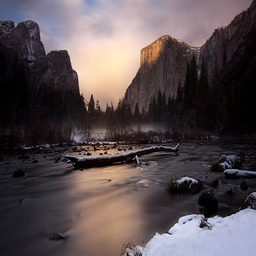

Reconstruction


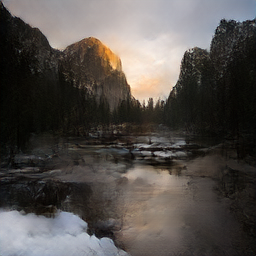

tensor(0.1300, device='cuda:0')
---------------------------------
Reconstruction


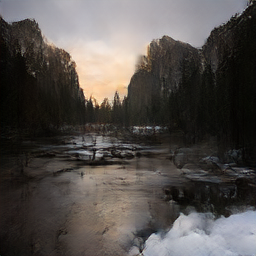

tensor(0.1304, device='cuda:0')
---------------------------------


In [942]:
img_list = [] # each element is a dictionary

# pick 3 images from both A and B set
style_num = 1

testA_set = dataset_single(root, 'test', 'B', model.first_stage_model)

A_list = [20, 167, 74, 1, 224, 17, 125]
# for i in A_list[-3:-2]:
# for i in range(11, 21):
for i in range(1):
#     img = testA_set[random.randint(0, testA_set.size-1)]
    img = testA_set[20] # 2
#     show_image(img['image'])
    show_image(img['flip_image'])
    
    _, z_indices, z_indices_shape = get_content_z(img['image'], img['label'])
    _, z_flip_indices, _ = get_content_z(img['flip_image'], img['label'])

    rec = show_recon(z_indices, img['style'], img['label'], img['image'])
    rec_flip = show_recon(z_flip_indices, img['flip_style'], img['label'], img['flip_image'])
#     img_list.append(img)

Reconstruction


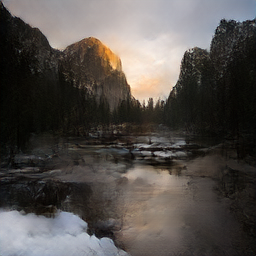

tensor(0.1300, device='cuda:0')
---------------------------------
Reconstruction


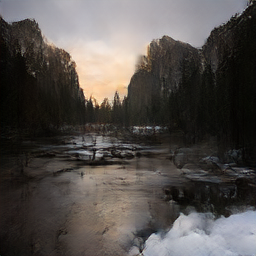

tensor(0.1304, device='cuda:0')
---------------------------------


In [943]:
_, z_indices, z_indices_shape = get_content_z(img['image'], img['label'])
_, z_flip_indices, _ = get_content_z(img['flip_image'], img['label'])

rec = show_recon(z_indices, img['style'], img['label'], img['image'])
rec_flip = show_recon(z_flip_indices, img['flip_style'], img['label'], img['flip_image'])

In [953]:
idx = get_rand_input(z_indices)
flip_idx = get_rand_input(z_flip_indices)

tau = 5.0#5.0 # 5.0~10.0
top_k = 2#5 # 2~5

gen_idx = sythesize(idx, _, label=A_content['label'], temperature=tau, top_k=top_k)

(1, 512, 16, 28)
Time: 5.47310209274292 seconds


In [949]:
gen_flip_idx = sythesize(flip_idx, _, label=A_content['label'], temperature=tau, top_k=top_k)
# print(gen_idx)
# print(gen_flip_idx)

(1, 512, 16, 28)
Time: 5.476301908493042 seconds


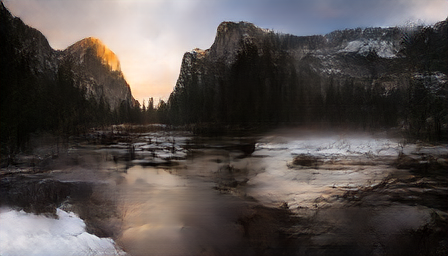

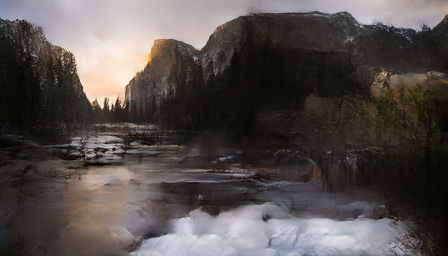

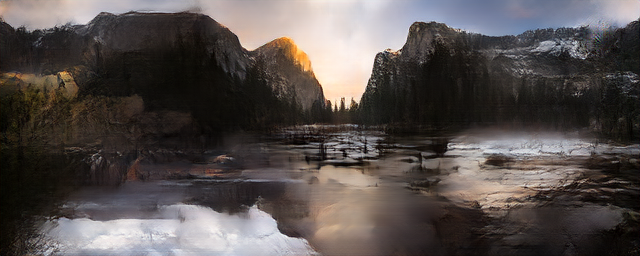

torch.Size([1, 3, 256, 640])


In [954]:
gen_img = model.decode_to_img(gen_idx, z_code_shape, img['style'], img['label'])
show_image(gen_img)

# gen_flip_img = model.decode_to_img(gen_flip_idx, z_code_shape, img['style'], img['label'])
# show_image(gen_flip_img)
# print(gen_img.shape)


### Fix decoder problem: flip latent first --> decode --> flip again
### -- Proposed by Kao
tmp = torch.flip(gen_flip_idx, [2])
gen_flip_img = model.decode_to_img(tmp, z_code_shape, img['style'], img['label'])
# show_image(gen_flip_img)
show_image(torch.flip(gen_flip_img, [3]))

# merge two-sided indices
tmp = torch.flip(gen_flip_idx, [2])
concate_flip = torch.cat((tmp[:, :, :tmp.shape[2]-tmp.shape[1]], gen_idx), 2)
gen_two_sided = model.decode_to_img(concate_flip, 
                              (1, codebook_size, concate_flip.shape[1], concate_flip.shape[2]),
                              img['style'], img['label'])
show_image(gen_two_sided)
print(gen_two_sided.shape)

### Save current generation

In [955]:
torch.save({
    'img_info': img,
    'idx': gen_idx,
    'flip_idx': gen_flip_idx
    },
    os.path.join( os.getcwd(), 'two_sided_idx', '{}.pt'.format(get_timestep()))
)

### Load a checkpoint

2012-08-03 21:43:11.jpg


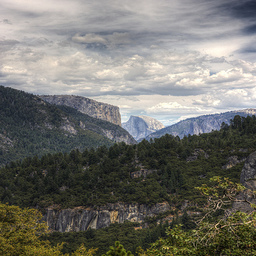

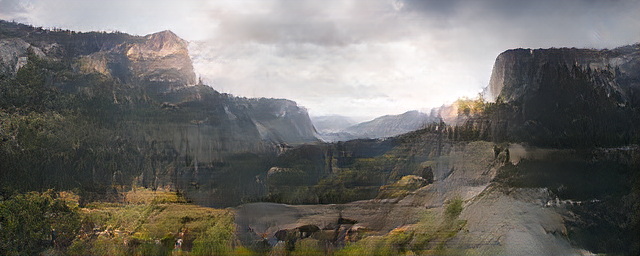

In [572]:
f = os.path.join( os.getcwd(), 'two_sided_idx', '0824_21_59_04.pt')
ck = torch.load(f, map_location=device)
test_img_info = ck['img_info']
test_idx = ck['idx']
test_flip_idx = ck['flip_idx']

print(test_img_info['img_name'])
show_image(test_img_info['image'])
_tmp = torch.flip(test_flip_idx, [2])
test_flip = torch.cat((_tmp[:, :, :_tmp.shape[2]-_tmp.shape[1]], test_idx), 2)
test_two_sided = model.decode_to_img(test_flip, 
                              (1, codebook_size, test_flip.shape[1], test_flip.shape[2]),
                              test_img_info['style'], test_img_info['label'])
show_image(test_two_sided)

---

Index: 174
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testA/2012-06-14 16:55:30.jpg


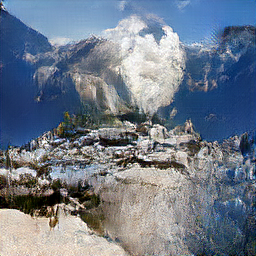

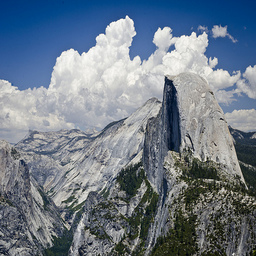

Index: 134
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testA/2016-08-05 00:00:00.jpg


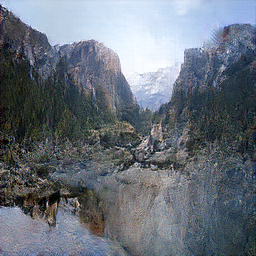

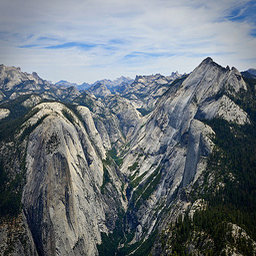

Index: 255
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testA/2011-07-12 09:31:30.jpg


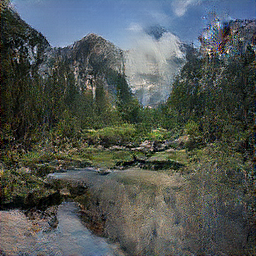

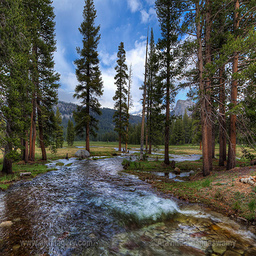

Index: 300
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testA/2014-06-29 17:17:01.jpg


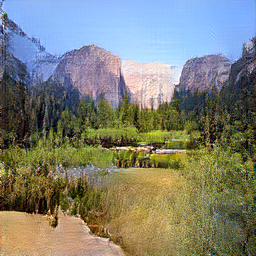

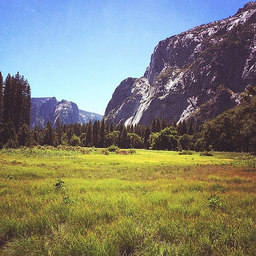

Index: 109
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testA/2011-07-03 17:23:51.jpg


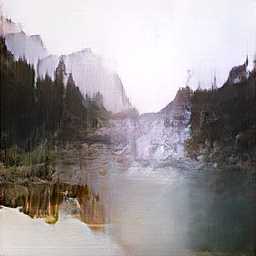

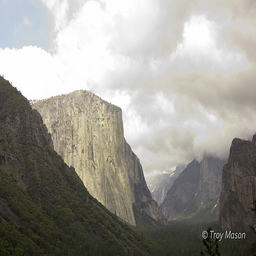

Index: 60
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testA/2016-08-29 07:05:51.jpg


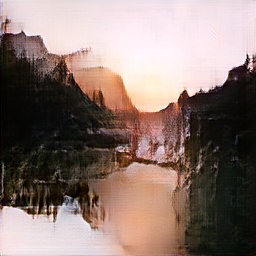

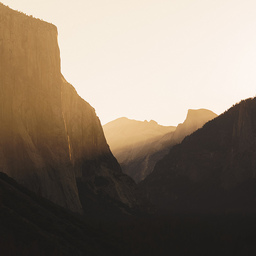

Index: 307
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testA/2016-07-24 23:14:50.jpg


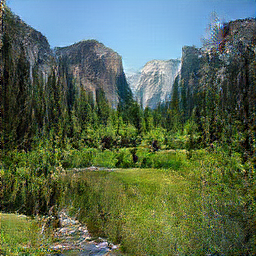

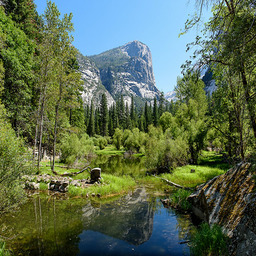

Index: 265
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testA/2012-08-15 09:39:40.jpg


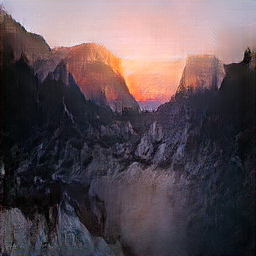

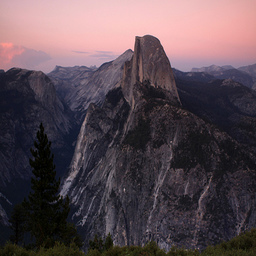

Index: 295
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testA/2012-07-02 08:16:51.jpg


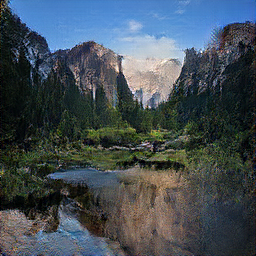

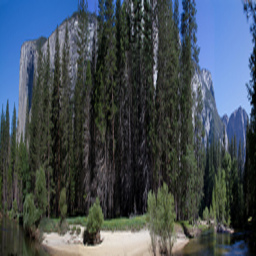

Index: 246
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testA/2012-02-24 14:44:31.jpg


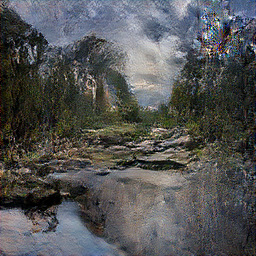

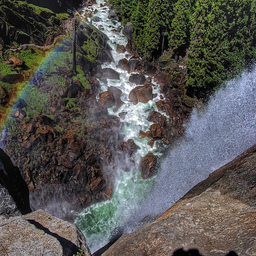

Index: 85
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testA/2013-08-17 03:43:50.jpg


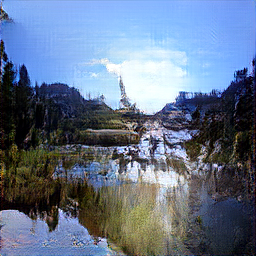

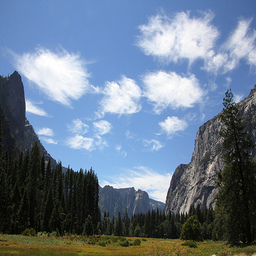

Index: 78
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testA/2013-07-04 20:50:50.jpg


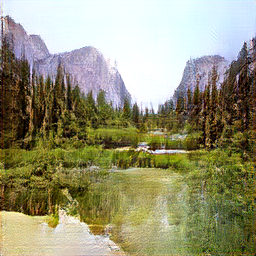

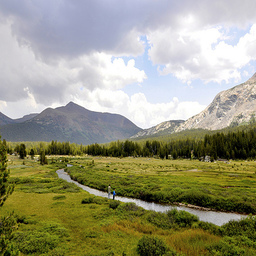

Index: 207
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testA/2013-07-19 20:17:50.jpg


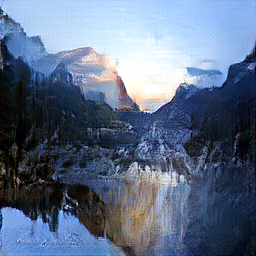

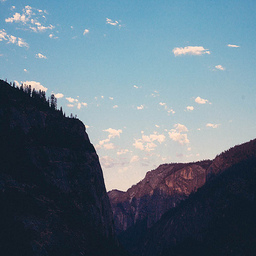

Index: 135
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testA/2012-08-20 12:51:40.jpg


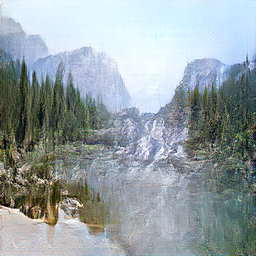

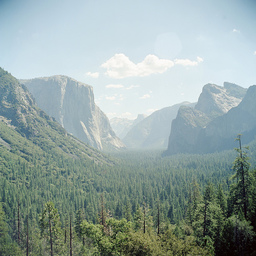

Index: 77
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testA/2014-08-13 22:02:31.jpg


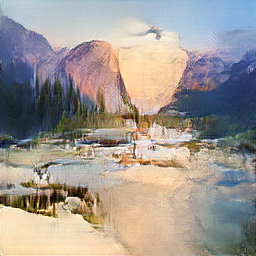

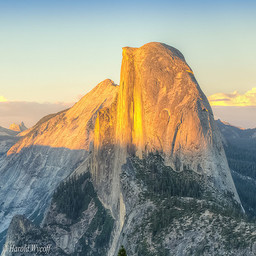

Index: 209
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testA/2011-09-04 05:55:21.jpg


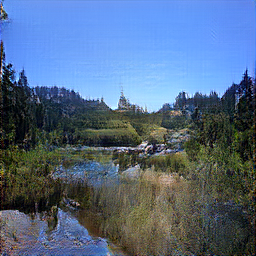

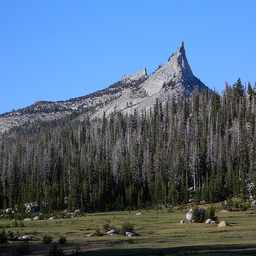

Index: 203
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testA/2014-08-29 19:35:20.jpg


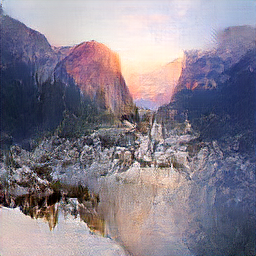

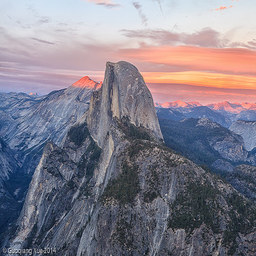

Index: 47
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testA/2011-07-11 23:18:31.jpg


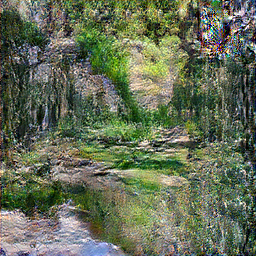

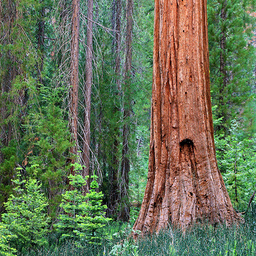

Index: 156
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testA/2011-06-04 19:38:11.jpg


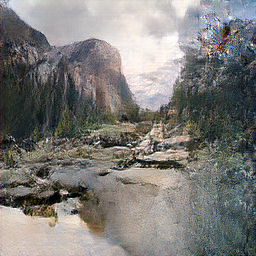

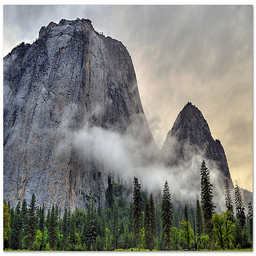

Index: 49
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testA/2014-07-01 14:34:31.jpg


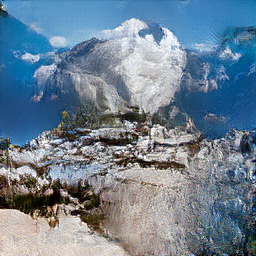

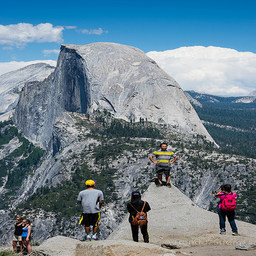

In [956]:
img_list = [] # each element is a dictionary

# pick 3 images from both A and B set
style_num = 1

testA_set = dataset_single(root, 'test', 'A', model.first_stage_model)

A_list = [108, 131, 209, 176, 74]
# for i in A_list[-3:]:
for i in range(61, 81):
    _im = testA_set[random.randint(0, testA_set.size-1)]
#     _im = testA_set[152]
    
    x_sample = model.decode_to_img(
        z_indices.reshape(z_code_shape[0], original_size, original_size), 
        (z_code_shape[0], codebook_size, original_size, original_size), _im['style'], _im['label'])
    
    show_image(x_sample)

    show_image(_im['image'])
    img_list.append(_im)

Index: 221
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testB/2011-01-09 22:59:11.jpg


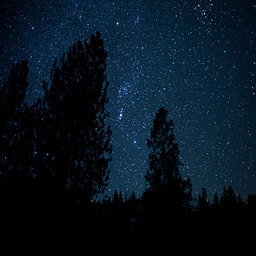

Reconstruction


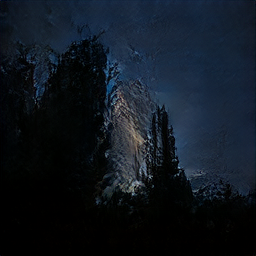

tensor(0.0826, device='cuda:0')
---------------------------------
Index: 222
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testB/2013-12-28 14:46:00.jpg


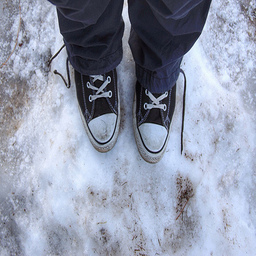

Reconstruction


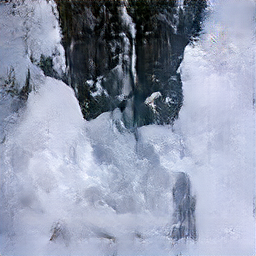

tensor(0.1777, device='cuda:0')
---------------------------------
Index: 223
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testB/2012-12-25 14:28:50.jpg


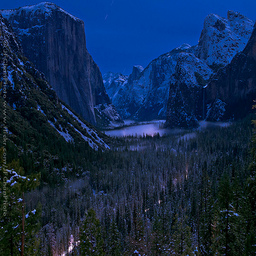

Reconstruction


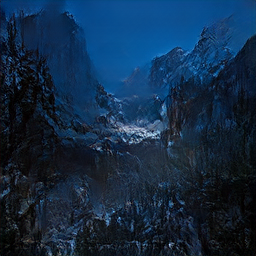

tensor(0.1377, device='cuda:0')
---------------------------------
Index: 224
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testB/2016-02-28 04:04:00.jpg


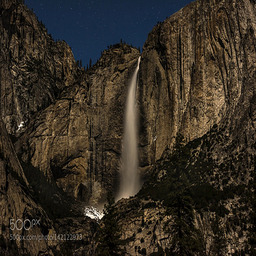

Reconstruction


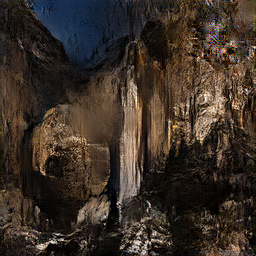

tensor(0.2006, device='cuda:0')
---------------------------------
Index: 225
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testB/2012-01-18 20:28:00.jpg


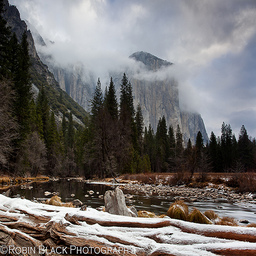

Reconstruction


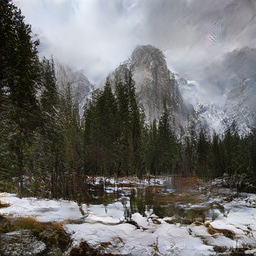

tensor(0.2305, device='cuda:0')
---------------------------------
Index: 226
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testB/2011-04-02 12:03:50.jpg


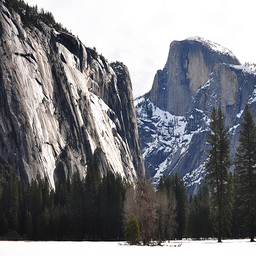

Reconstruction


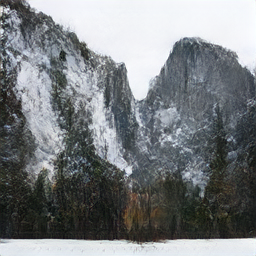

tensor(0.2155, device='cuda:0')
---------------------------------
Index: 227
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testB/2011-09-13 09:54:51.jpg


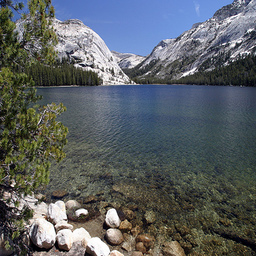

Reconstruction


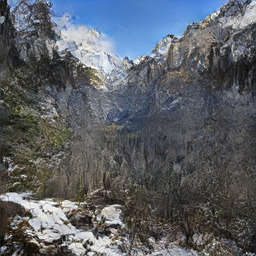

tensor(0.2280, device='cuda:0')
---------------------------------
Index: 228
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testB/2014-03-10 15:54:20.jpg


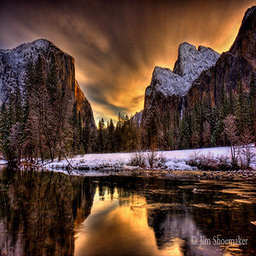

Reconstruction


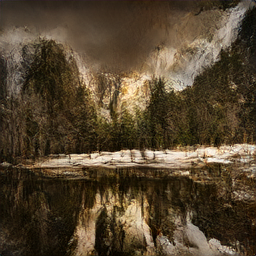

tensor(0.2194, device='cuda:0')
---------------------------------
Index: 229
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testB/2009-11-15 17:03:20.jpg


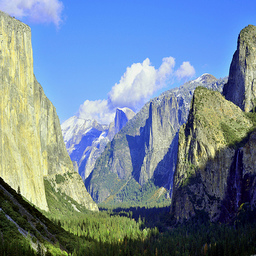

Reconstruction


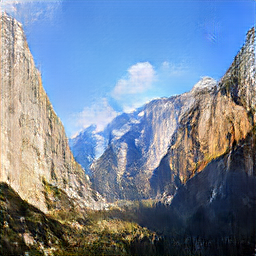

tensor(0.1926, device='cuda:0')
---------------------------------
Index: 230
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testB/2016-05-10 15:33:51.jpg


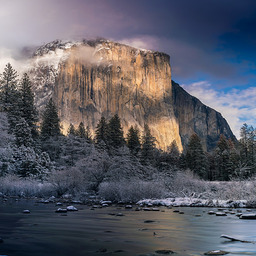

Reconstruction


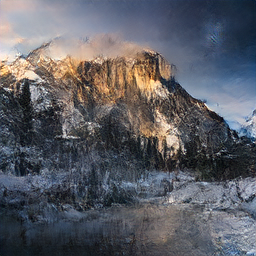

tensor(0.1832, device='cuda:0')
---------------------------------
Index: 231
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testB/2015-12-31 14:54:20.jpg


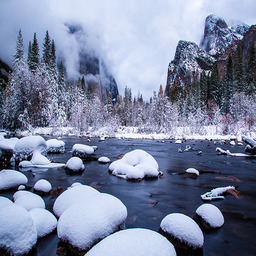

Reconstruction


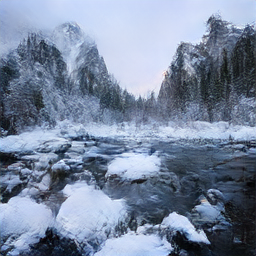

tensor(0.2319, device='cuda:0')
---------------------------------
Index: 232
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testB/2013-10-02 20:41:40.jpg


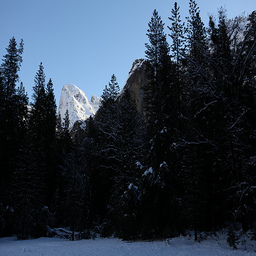

Reconstruction


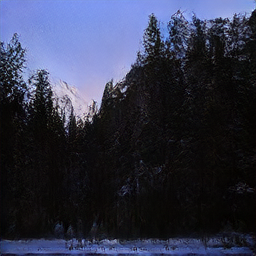

tensor(0.1338, device='cuda:0')
---------------------------------
Index: 233
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testB/2011-10-31 11:56:00.jpg


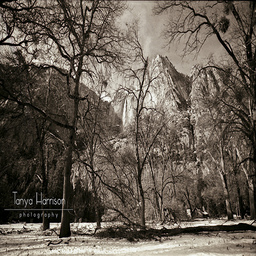

Reconstruction


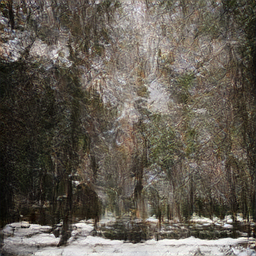

tensor(0.2665, device='cuda:0')
---------------------------------
Index: 234
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testB/2010-10-13 23:08:10.jpg


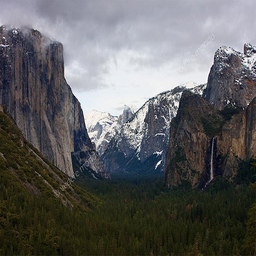

Reconstruction


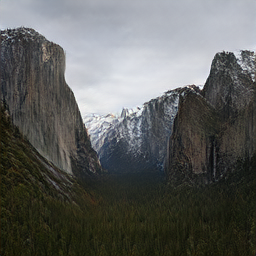

tensor(0.1157, device='cuda:0')
---------------------------------
Index: 235
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testB/2012-12-16 17:51:00.jpg


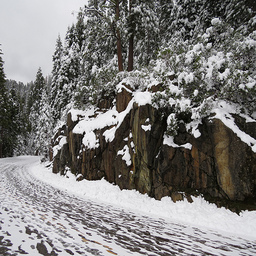

Reconstruction


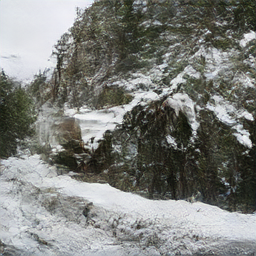

tensor(0.2985, device='cuda:0')
---------------------------------
Index: 236
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testB/2016-03-11 22:19:10.jpg


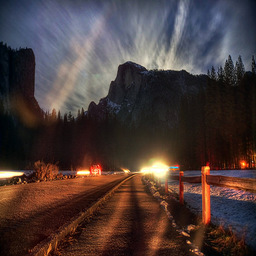

Reconstruction


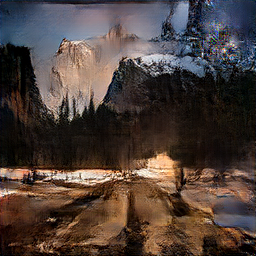

tensor(0.1854, device='cuda:0')
---------------------------------
Index: 237
Image Path: /eva_data_2/vqi2i/datasets/summer2winter_yosemite/testB/2012-12-11 18:32:10.jpg


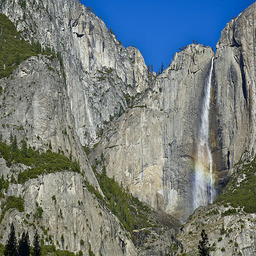

Reconstruction


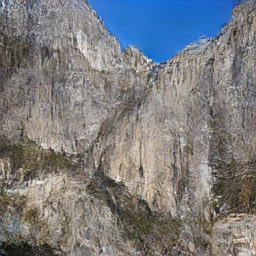

tensor(0.2308, device='cuda:0')
---------------------------------


In [963]:
testB_set = dataset_single(root, 'test', 'B', model.first_stage_model)

B_list = [ 12, 152, 166, 140, 64, 205, 115, 22, 194, 116, 28, 214 , 193, 170, 117, 204, 45, 234, 160]
# for i in B_list[-3:]:
style_num = testB_set.size
img_list = []
for i in range(221, 238):
#     _im = testB_set[random.randint(0, testB_set.size-1)]
    _im = testB_set[i]
    show_image(_im['image'])
    
    
    _, z_indices, z_indices_shape = get_content_z(_im['image'], _im['label'])
    _, z_flip_indices, _ = get_content_z(_im['flip_image'], _im['label'])

    rec = show_recon(z_indices, _im['style'], _im['label'], _im['image'])
    
#     x_sample = model.decode_to_img(
#         z_indices.reshape(z_code_shape[0], original_size, original_size), 
#         (z_code_shape[0], codebook_size, original_size, original_size), _im['style'], _im['label'])
    
#     show_image(x_sample)
    
#     img_list.append(_im)    

# len(img_list)

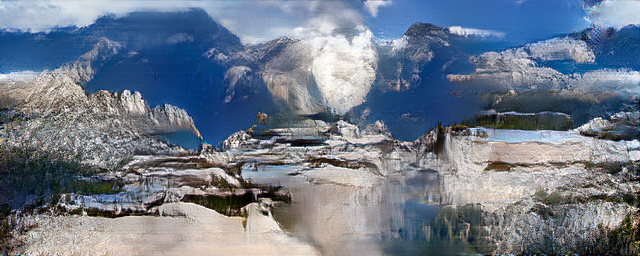

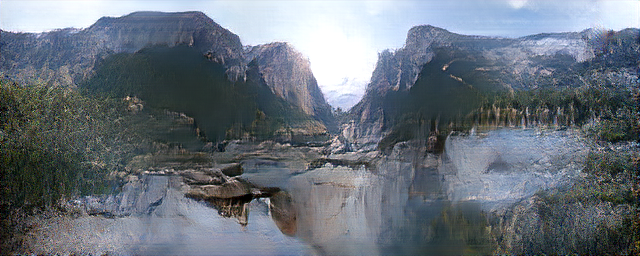

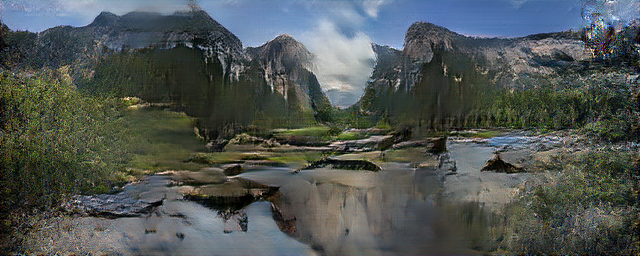

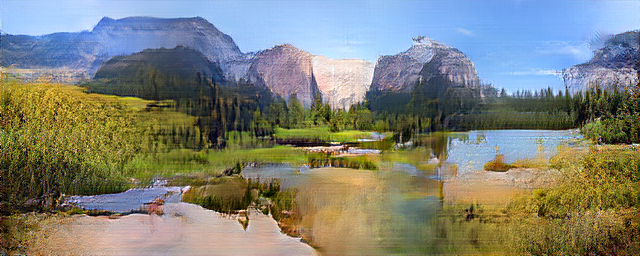

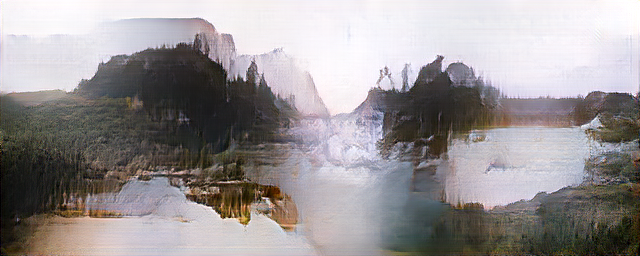

...

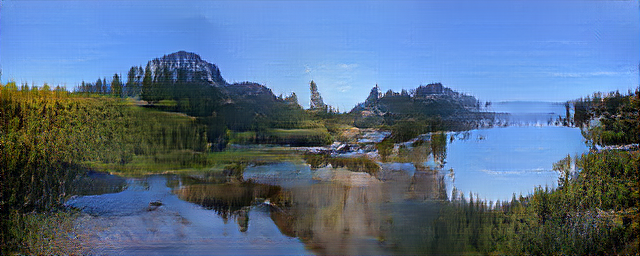

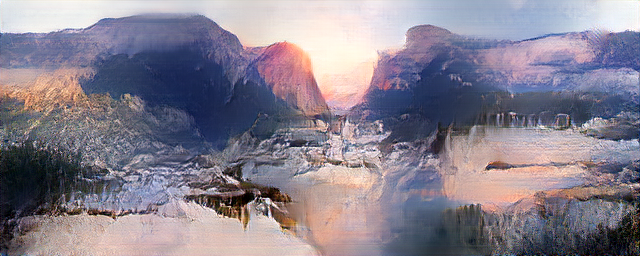

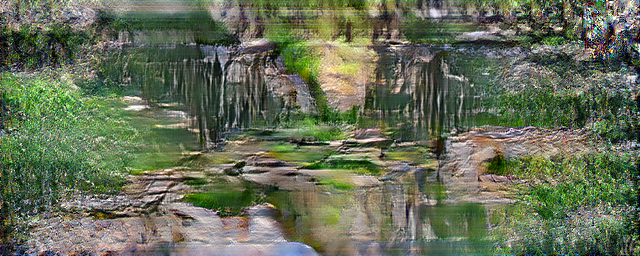

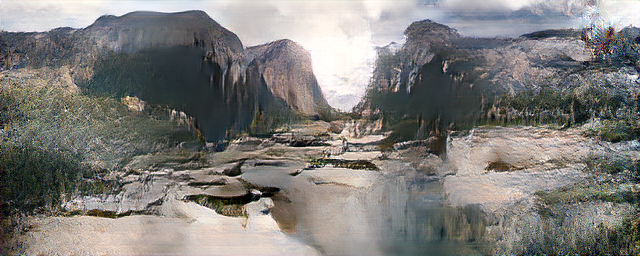

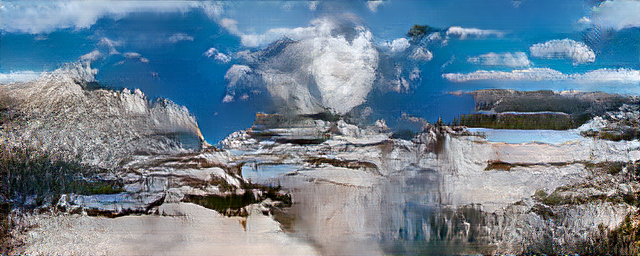

In [957]:
for _img in img_list:
    
    _gen = model.decode_to_img(concate_flip, 
                              (1, codebook_size, concate_flip.shape[1], concate_flip.shape[2]),
                              _img['style'], _img['label'])
    show_image(_gen)